Start by copying this into your Google Drive!!

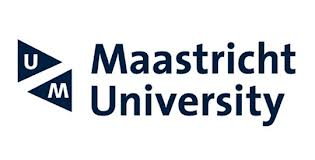
#Faculty of Science and Engineering - Department of Advanced Computer Sciences
# Course Advanced Natural Language Processing (ANLP) - Tutorial Ethical Aspects of AI in NLP and XAI

By Jan Scholtes

Welcome to the tutorial on eXplainable Artificial Intelligence (XAI) in Natural Langage Processing (NLP). In this notebook you will get introduced to different models used to manage a human-computer dialogue.

For this notebook we would need our GPU again. You can activate your GPU by clicking on Runtime, then Change runtime type and pressing GPU. If you hit the Google's GPU limits for usage, you can use other free GPU services such as Kaggle GPU's (recommended), Amazon's GPU's or Paperspace Gradient or of course your local GPU on your computer (if you have one).

XAI requires:

**Transparency** is given “if the processes that extract model parameters from training data and generate labels from testing data can be described and motivated by the approach designer”.

**Interpretability** describes the possibility to comprehend the ML model and to present the underlying basis for decision-making in a way that is understandable to humans.

**Explainabilit**y is a concept that is recognized as important, but a joint definition is not yet available. It is suggested that explainability in ML can be considered as “the collection of features of the interpretable domain, that have contributed for a given example to produce a decision (e.g., classification or regression)”.



source: DARPA

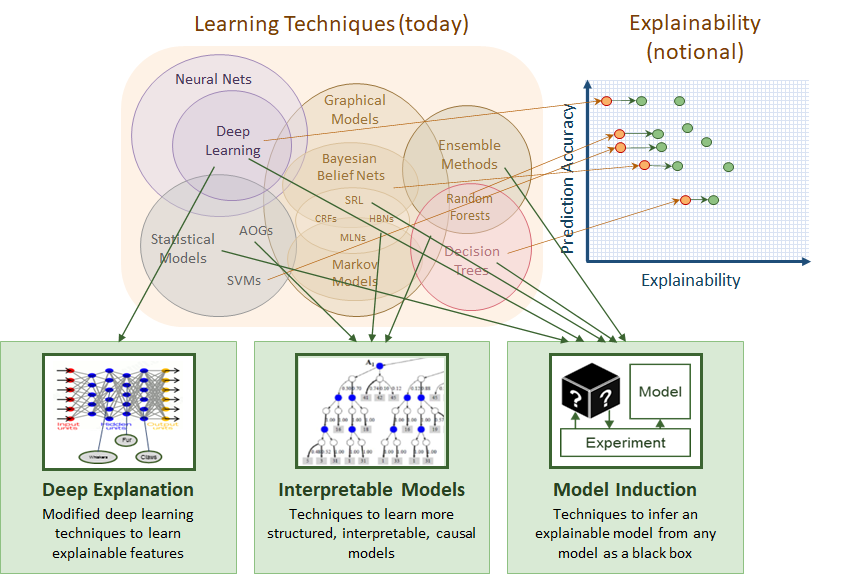

Explanation are part of a social interaction:

- Valid explanations should be sound, cogent, convincing and create trust. 
- The receiving party should be able to understand it.
- Step by step transfer of knowledge

Moreover explanations:

- Must show the difference between possible outcomes of decision.
- Should be relevant.
- Can be incomplete. Emphasizing a few examples may be sufficient. No need to be overly complete. 
- Should be believable; 

XAI in NLP is becoming more important as Large Language models are used for a variety of mission-critical and high-impact applications in our society. 

Several overview papers have been written recently, investigating existing approaches for XAI in NLP. Here are two important ones:

1) Analysis Methods in Neural Language Processing: A Survey
Yonatan Belinkov and James Glass. https://direct.mit.edu/tacl/article/doi/10.1162/tacl_a_00254/43503/Analysis-Methods-in-Neural-Language-Processing-A

2) A Survey of the State of Explainable AI for Natural Language Processing
Marina Danilevsky, Kun Qian, Ranit Aharonov, Yannis Katsis, Ban Kawas, Prithviraj Sen. https://arxiv.org/abs/2010.00711 

Relevant questions to ask are: what linguistic knowledge is captured by neural networks, why they make certain predictions, if they are robust, interpreting the way they represent language and how they fail. 

But how do you explain complex mathematics and machine learning algorithms to individuals that are not familiar with those concepts, let alone, really understand these?

In the following paper, these problems are discussed:

1) The Mythos of Model Interpretability by Zachary C. Lipton. https://arxiv.org/abs/1606.03490 

2) DARPA program onExplainable Artificial Intelligence (XAI) by Dr. Matt Turek. https://www.darpa.mil/program/explainable-artificial-intelligence 

Both are important to understand psychologfical aspects of "explainability" and "understanding" and different approaches taking in similar situations. 

In this tutorial, we will look into a number of examples of methods used to explain the inner workings of AI algorithms in various applications of NLP.

# BERT-Viz

BertViz is an interactive tool for visualizing attention in Transformer language models such as BERT, GPT2, or T5. It can be run inside a Jupyter or Colab notebook through a simple Python API that supports most Huggingface models. BertViz extends the Tensor2Tensor visualization tool by Llion Jones, providing multiple views that each offer a unique lens into the attention mechanism.

We already used these methods in the Deep Learning Transformer Tutorial, but  let's take another look. 

In [ ]:
!pip install bertviz

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 157 kB 13.6 MB/s 
     |████████████████████████████████| 1.3 MB 53.1 MB/s 
     |████████████████████████████████| 5.8 MB 63.4 MB/s 
     |████████████████████████████████| 132 kB 47.4 MB/s 
     |████████████████████████████████| 7.6 MB 29.4 MB/s 
     |████████████████████████████████| 182 kB 75.1 MB/s 
     |████████████████████████████████| 10.2 MB 50.1 MB/s 
     |████████████████████████████████| 79 kB 3.7 MB/s 
     |████████████████████████████████| 140 kB 73.9 MB/s 
     |████████████████████████████████| 127 kB 54.1 MB/s 
  Attempting uninstall: urllib3
    Found existing installation: urllib3 1.24.3
    Uninstalling urllib3-1.24.3:
      Successfully uninstalled urllib3-1.24.3


In [ ]:
# Load model and retrieve attention weights

from bertviz import head_view, model_view
from transformers import BertTokenizer, BertModel

model_version = 'bert-base-uncased'
model = BertModel.from_pretrained(model_version, output_attentions=True)
tokenizer = BertTokenizer.from_pretrained(model_version)
sentence_a = "The cat sat on the mat"
sentence_b = "The cat lay on the rug"
inputs = tokenizer.encode_plus(sentence_a, sentence_b, return_tensors='pt')
input_ids = inputs['input_ids']
token_type_ids = inputs['token_type_ids']
attention = model(input_ids, token_type_ids=token_type_ids)[-1]
sentence_b_start = token_type_ids[0].tolist().index(1)
input_id_list = input_ids[0].tolist() # Batch index 0
tokens = tokenizer.convert_ids_to_tokens(input_id_list) 

Downloading:   0%|          | 0.00/570 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.LayerNorm.weight']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/28.0 [00:00<?, ?B/s]

## The Head View

The head view visualizes attention in one or more heads from a single Transformer layer. Each line shows the attention from one token (left) to another (right). Line weight reflects the attention value (ranges from 0 to 1), while line color identifies the attention head. When multiple heads are selected (indicated by the colored tiles at the top), the corresponding visualizations are overlaid onto one another. For a more detailed explanation of attention in Transformer models, please refer to the blog.

Usage
- Hover over any token on the left/right side of the visualization to filter attention from/to that token.
- Double-click on any of the colored tiles at the top to filter to the corresponding attention head.
- Single-click on any of the colored tiles to toggle selection of the corresponding attention head.
- Click on the Layer drop-down to change the model layer (zero-indexed).

In [ ]:
head_view(attention, tokens, sentence_b_start)

<IPython.core.display.Javascript object>

## The Model View
The model view provides a birds-eye view of attention throughout the entire model. Each cell shows the attention weights for a particular head, indexed by layer (row) and head (column). The lines in each cell represent the attention from one token (left) to another (right), with line weight proportional to the attention value (ranges from 0 to 1). For a more detailed explanation, please refer to the blog.

Usage
- Click on any cell for a detailed view of attention for the associated attention head (or to unselect that cell).
- Then hover over any token on the left side of detail view to filter the attention from that token.

In [ ]:
model_view(attention, tokens, sentence_b_start)

<IPython.core.display.Javascript object>

## The Neuron View
The neuron view visualizes the intermediate representations (e.g. query and key vectors) that are used to compute attention. In the collapsed view (initial state), the lines show the attention from each token (left) to every other token (right). In the expanded view, the tool traces the chain of computations that produce these attention weights. For a detailed explanation of the attention mechanism, please refer to the blog.

Usage
- Hover over any of the tokens on the left side of the visualization to filter attention from that token.
- Then click on the plus icon that is revealed when hovering. This exposes the query vectors, key vectors, and other intermediate representations used to compute the attention weights. Each color band represents a single neuron value, where color intensity indicates the magnitude and hue the sign (blue=positive, orange=negative).
- Once in the expanded view, hover over any other token on the left to see the associated attention computations.
- Click on the Layer or Head drop-downs to change the model layer or head (zero-indexed).

In [ ]:
from bertviz.transformers_neuron_view import BertModel, BertTokenizer
from bertviz.neuron_view import show

model_type = 'bert'
model_version = 'bert-base-uncased'
model = BertModel.from_pretrained(model_version, output_attentions=True)
tokenizer = BertTokenizer.from_pretrained(model_version, do_lower_case=True)
show(model, model_type, tokenizer, sentence_a, sentence_b, display_mode="light", layer=4, head=3)

100%|██████████| 231508/231508 [00:00<00:00, 902619.82B/s]


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# exBERT

ExBERT is another model explaining the innerworkings of Transformers developed by MIT-IBM AI Labs and Harvard NLP Group. 

ExBERT does not only provide insight into attention mechanisms, but also combines them with the contextual word embeddings to provide better insight in these important relations as well. According to the authors: "While static analyses of these models lead to targeted insights, interactive tools are more dynamic and can help humans better gain an intuition for the model internal reasoning process. We present EXBERT, an interactive tool named after the popular BERT language model, that provides insights into the meaning of the
contextual representations by matching a human-specified input to similar contexts in a large annotated dataset. By aggregating the annotations of the matching similar contexts, EXBERT helps intuitively explain what each attention-head has learned."

The paper can be found here: https://arxiv.org/pdf/1910.05276.pdf and the source code here: https://github.com/bhoov/exbert

Reference: EXBERT: A Visual Analysis Tool to Explore Learned Representations in Transformers Models. Hoover et al. 2019.




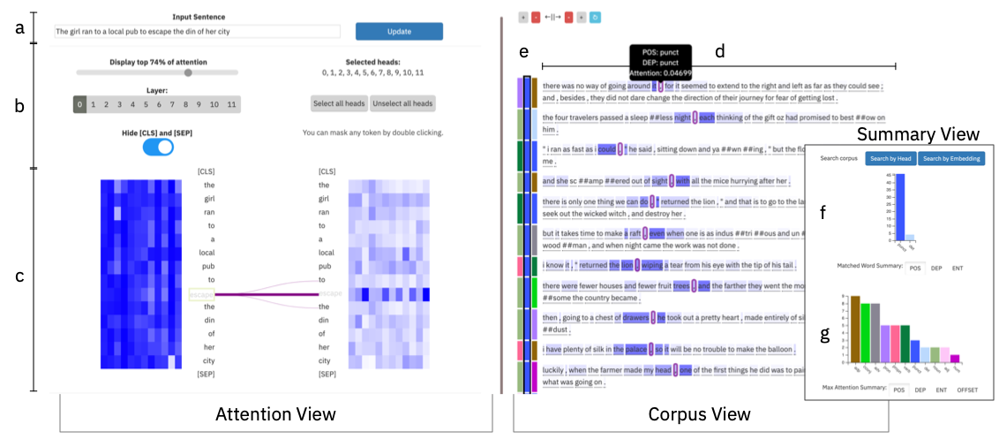

# pyLDAViz

Topic modelling in natural language processing is a technique which assigns topic to a given corpus based on the words present. In natural language processing, Latent Dirichlet Allocation (LDA) is a generative statistical model that explains a set of observations through unobserved groups, and each group explains why some parts of the data are similar. The LDA is an example of a topic model. In this, observations (e.g., words) are collected into documents, and each word's presence is attributable to one of the document's topics. Each document will contain a small number of topics. See also: https://en.wikipedia.org/wiki/Latent_Dirichlet_allocation 

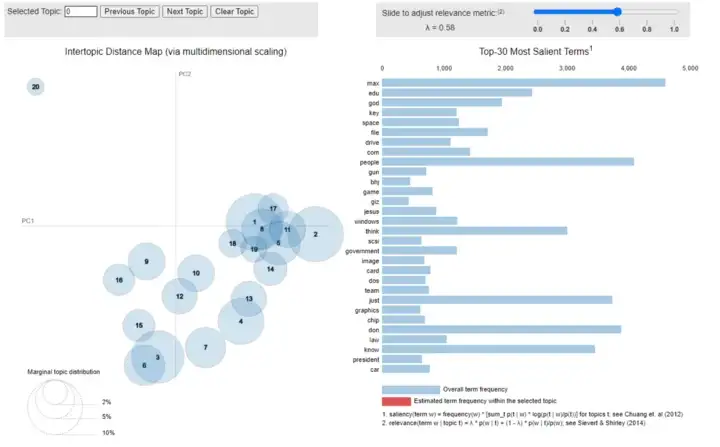

pyLDAViz is a Python Library to visualize topics and related keywords. The gensim implementation of pyLDAviz does not really work (bug in dependencies), however, the skilearn one does works as expected. 

Try it yourself with the  code below. Calculating the LDA may take up to 3 minutes.  



In [ ]:
from __future__ import print_function
!pip install pyldavis
import warnings
warnings.filterwarnings('ignore')
import pyLDAvis
import pyLDAvis.sklearn
pyLDAvis.enable_notebook()
from sklearn.datasets import fetch_20newsgroups
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation
newsgroups = fetch_20newsgroups(remove=('headers', 'footers', 'quotes'))
docs_raw = newsgroups.data
print(len(docs_raw))
tf_vectorizer = CountVectorizer(strip_accents = 'unicode',
                                stop_words = 'english',
                                lowercase = True,
                                token_pattern = r'\b[a-zA-Z]{3,}\b',
                                max_df = 0.5, 
                                min_df = 10)
dtm_tf = tf_vectorizer.fit_transform(docs_raw)
tfidf_vectorizer = TfidfVectorizer(**tf_vectorizer.get_params())
dtm_tfidf = tfidf_vectorizer.fit_transform(docs_raw)
# for TF DTM
lda_tf = LatentDirichletAllocation(n_components=20, random_state=0)
lda_tf.fit(dtm_tf)
# for TFIDF DTM
lda_tfidf = LatentDirichletAllocation(n_components=20, random_state=0)
lda_tfidf.fit(dtm_tfidf)
pyLDAvis.sklearn.prepare(lda_tf, dtm_tf, tf_vectorizer)


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.7 MB 33.2 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
    Preparing wheel metadata ... done
  Created wheel for pyldavis: filename=pyLDAvis-3.3.1-py2.py3-none-any.whl size=136898 sha256=36325df6bb06384b4f25a26176bfdbcf3abdea98a2791c56389734dfe5156036
  Stored in directory: /root/.cache/pip/wheels/90/61/ec/9dbe9efc3acf9c4e37ba70fbbcc3f3a0ebd121060aa593181a
  Created wheel for sklearn: filename=sklearn-0.0.post1-py3-none-any.whl size=2344 sha256=f64cc3787d3c46484d3f09c153506e7149ab575ff8ba362cc10b438f61d257f5
  Stored in directory: /root/.cache/pip/wheels/14/25/f7/1cc0956978ae479e75140219088deb7a36f60459df242b1a72
Successfully built pyldavis sklearn


/usr/local/lib/python3.8/dist-packages/past/types/oldstr.py:5: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3, and in 3.10 it will stop working
  from collections import Iterable
/usr/local/lib/python3.8/dist-packages/past/builtins/misc.py:4: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3, and in 3.10 it will stop working
  from collections import Mapping


11314


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
6      0.080525  0.084967       1        1  10.698914
14     0.196207  0.062185       2        1  10.077951
0     -0.102869 -0.170439       3        1   9.104501
18     0.054788 -0.103025       4        1   7.036540
13     0.125707  0.045466       5        1   6.281324
8     -0.128318 -0.186213       6        1   5.411451
19    -0.012272 -0.152626       7        1   5.387479
12     0.094636  0.071910       8        1   5.377476
9     -0.124044  0.010609       9        1   4.547461
7     -0.030445 -0.011852      10        1   4.498512
5      0.142672  0.071664      11        1   4.342297
1     -0.061581 -0.055212      12        1   4.146615
15     0.069750 -0.060217      13        1   4.078443
2      0.110436 -0.003365      14        1   3.673889
11    -0.138638 -0.110874      15        1   3.391038
3     -0.176262 -0.024068      16        1   3.240042
17     0.115595  0.110588      17        1   2.977799
4      0.038802  0.044731      18        1   2.548118
10     0.079317  0.034016      19        1   2.216235
16    -0.334006  0.341754      20        1   0.963914, topic_info=            Term         Freq        Total Category  logprob  loglift
5016         max  4601.000000  4601.000000  Default  30.0000  30.0000
2653         edu  2438.000000  2438.000000  Default  29.0000  29.0000
3523         god  1945.000000  1945.000000  Default  28.0000  28.0000
4497         key  1211.000000  1211.000000  Default  27.0000  27.0000
7677       space  1250.000000  1250.000000  Default  26.0000  26.0000
...          ...          ...          ...      ...      ...      ...
8805     virtual    15.110336   134.053142  Topic20  -6.2580   2.4591
5140         mil    13.665991   113.450206  Topic20  -6.3585   2.5255
6642     reality    15.259194   189.037514  Topic20  -6.2482   2.1252
7221  scientific    15.126340   248.731356  Topic20  -6.2570   1.8420
2749         end    13.682255   852.822371  Topic20  -6.3573   0.5095

[1419 rows x 6 columns], token_table=      Topic      Freq          Term
term                               
20       11  0.929034     absolutes
20       17  0.038710     absolutes
37       12  0.032754  accelerators
37       13  0.032754  accelerators
37       14  0.884362  accelerators
...     ...       ...           ...
9113     19  0.022005         years
9114     14  0.972649         yeast
9132      9  0.041934       yzerman
9132     18  0.922552       yzerman
9134      6  0.949301        zenith

[5975 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[7, 15, 1, 19, 14, 9, 20, 13, 10, 8, 6, 2, 16, 3, 12, 4, 18, 5, 11, 17])

# Post-Hoc XAI Methods

Where BERTViz, exBERT and pyLDAViz provide insight into specific values of local features, connections, weights or (self-)attention, it does not explain us how a decision was made or what the output would have been should we have used other values. Methods that provide more insight in how the model got to it's final decision can be obtained by using Saliency (maps), LIME, or Shapley values. 

We will look into these models now. You can find more references on these models below. 

Saliency: 
- AllenNLP Interpret: A Framework for Explaining Predictions of NLP Models
Eric Wallace et al. 2019. https://arxiv.org/abs/1909.09251 
- Explaining Black Box Predictions and Unveiling Data Artifacts
through Influence Functions. Han et al/. 2020.https://arxiv.org/abs/2005.06676 
- A Diagnostic Study of Explainability Techniques for Text Classification. Pepa Atanasova et al., 2020. https://aclanthology.org/2020.emnlp-main.263/ 

Lime: 
- "Why Should I Trust You?": Explaining the Predictions of Any Classifier
Marco Tulio Ribeiro, 2016. https://arxiv.org/abs/1602.04938 

Sharpley: 
- Winter, E. The shapley value. Handbook of game theory
with economic applications, 3:2025–2054, 2002. 


## Saliency, FFNN and Hidden Layer Evolution

Let's take a closer look at Saliency models. The following part of the tutorial is from this blog https://jalammar.github.io/explaining-transformers/ and this original tutorial: https://colab.research.google.com/github/jalammar/ecco/blob/main/notebooks/readme.md%20examples.ipynb#scrollTo=303edda7 


In [ ]:
!pip install ecco
import ecco

lm = ecco.from_pretrained('t5-small')
review="""Denis Villeneuve's Dune looks and sounds amazing -- and once the 
(admittedly slow-building) story gets you hooked, you'll be on the edge 
of your seat for the sequel."""

output = lm.generate(f"sst2 sentence: {review}", generate=1, do_sample=False)

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 70 kB 4.6 MB/s 
     |████████████████████████████████| 1.4 MB 44.5 MB/s 
     |████████████████████████████████| 24.9 MB 1.5 MB/s 
     |████████████████████████████████| 662 kB 65.2 MB/s 
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.0.2
    Uninstalling scikit-learn-1.0.2:
      Successfully uninstalled scikit-learn-1.0.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
yellowbrick 1.5 requires scikit-learn>=1.0.0, but you have scikit-learn 0.24.2 which is incompatible.


Downloading:   0%|          | 0.00/1.20k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/792k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.39M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/242M [00:00<?, ?B/s]

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


Use a large language model (T5 in this case) to detect text sentiment. In addition to the sentiment, see the tokens the model broke the text into (which can help debug some edge cases).

### Which words in this review lead the model to classify its sentiment as "negative"?
ANSWER:weakness and expect

In [ ]:
import ecco
lm = ecco.from_pretrained('t5-small', verbose=False)
review="""I have a well-documented weakness for sci-fi and expected Dune 
to feed my soul. I didn't expect it to entirely blow my mind."""

output = lm.generate(f"sst2 sentence: {review}", generate=1, do_sample=False, attribution=['ig'])
output.primary_attributions(attr_method='ig', ignore_tokens=[0,1,2,3,4,5,6,43,44])

<IPython.core.display.Javascript object>


Feature attribution using Integrated Gradients helps you explore model decisions. In this case, switching "weakness" to "inclination" allows the model to correctly switch the prediction to *positive*.

### Explore the world knowledge of GPT models by posing fill-in-the blank questions.

In [ ]:
import ecco
lm = ecco.from_pretrained('gpt2')
prompt=""" Heathrow airport is located in the city of"""

output = lm.generate(prompt, generate=1, do_sample=False)

Downloading:   0%|          | 0.00/665 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.04M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/456k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/548M [00:00<?, ?B/s]

<IPython.core.display.Javascript object>

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


<IPython.core.display.Javascript object>


Does GPT2 know where Heathrow Airport is? Yes. It does.

### What other cities/words did the model consider in addition to London?

In [ ]:
import ecco
lm = ecco.from_pretrained('gpt2', verbose=False)
prompt=""" Heathrow airport is located in the city of"""

output = lm.generate(prompt, generate=1, do_sample=False, attribution=['ig'])
output.primary_attributions(attr_method='ig')

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


<IPython.core.display.Javascript object>


Visuals the candidate output tokens and their probability scores.

### Which input words lead it to think of London?

In [ ]:
output.layer_predictions(position=9, layer=11)

<IPython.core.display.Javascript object>


### At which layers did the model gather confidence that London is the right answer?

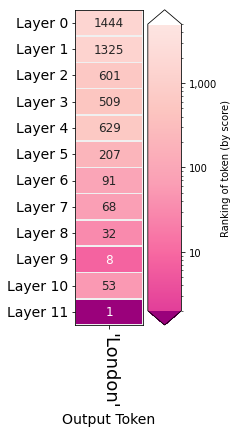

In [ ]:
output.rankings()


The model chose London by making the highest probability token (ranking it #1) after the last layer in the model. How much did each layer contribute to increasing the ranking of *London*? This is a [logit lens](https://www.lesswrong.com/posts/AcKRB8wDpdaN6v6ru/interpreting-gpt-the-logit-lens) visualizations that helps explore the activity of different model layers.

### What are the patterns in BERT neuron activation when it processes a piece of text? 

In [ ]:
import ecco
lm = ecco.from_pretrained('distilbert-base-uncased', activations=True)
text = ''' Now I ask you: \n what can be expected of man since he is a being endowed with strange qualities? Shower upon him every earthly blessing, drown him in a sea of happiness, so that nothing but bubbles of bliss can be seen on the surface; give him economic prosperity, such that he should have nothing else to do but sleep, eat cakes and busy himself with the continuation of his species, and even then out of sheer ingratitude, sheer spite, man would play you some nasty trick. He would even risk his cakes and would deliberately desire the most fatal rubbish, the most uneconomical absurdity, simply to introduce into all this positive good sense his fatal fantastic element. It is just his fantastic dreams, his vulgar folly that he will desire to retain, simply in order to prove to himself--as though that were so necessary-- that men still are men and not the keys of a piano, which the laws of nature threaten to control so completely that soon one will be able to desire nothing but by the calendar. And that is not all: even if man really were nothing but a piano-key, even if this were proved to him by natural science and mathematics, even then he would not become reasonable, but would purposely do something perverse out of simple ingratitude, simply to gain his point. And if he does not find means he will contrive destruction and chaos, will contrive sufferings of all sorts, only to gain his point! He will launch a curse upon the world, and as only man can curse (it is his privilege, the primary distinction between him and other animals), may be by his curse alone he will attain his object--that is, convince himself that he is a man and not a piano-key!
'''
inputs = lm.tokenizer([text], return_tensors="pt")
output = lm(inputs)
nmf_1 = output.run_nmf(n_components=8) 
nmf_1.explore()

Downloading:   0%|          | 0.00/28.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/483 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/466k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/268M [00:00<?, ?B/s]

Some weights of the model checkpoint at distilbert-base-uncased were not used when initializing DistilBertModel: ['vocab_layer_norm.bias', 'vocab_layer_norm.weight', 'vocab_transform.weight', 'vocab_projector.weight', 'vocab_projector.bias', 'vocab_transform.bias']
- This IS expected if you are initializing DistilBertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DistilBertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


<IPython.core.display.Javascript object>

##LIME

Another type of explainability techniques perturbs the input to find which regions from it change the prediction to a larger degree. One such method is LIME (https://arxiv.org/abs/1602.04938 ), which build a linear local approximator for each instance. It perturbs the input and tries to predict how the output is being changed with each local perturbation. The weights of the linear model for each token are used as saliency scores.

See this book on interpretability (https://christophm.github.io/interpretable-ml-book/lime.html ) for more information on LIME and it's usage in NLP. 

LIME can also be used to explain which words contribute most to the polarity in sentiment analysis. See for instance this LIME visualization used to examine the words used for the classification in negation handling. It can be observed that DON'T is notreconized as DON NOT and is this not contributing to the negative polarity of this sentence, hence the positive classification instead of the (correct) negative one. 

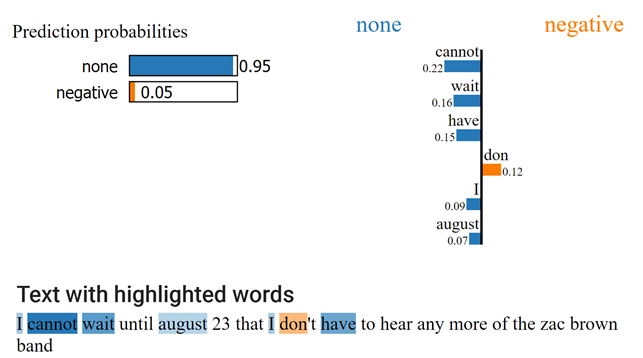



In this tutorial, you finetuned BERT for sentiment analysis: https://colab.research.google.com/drive/16hT3ZgRHslOPoPO-wKZ7gZr0Wy4TCbnZ#scrollTo=sQcW-cj9fowz 

### Exercise 1: 

1) Follow the same steps as in the previous tutorial to finetune BERT for sentiment analysis.

2) Also re-run the estimation of precision, recall and F1 values.

3) Take 3 data points that are correctly classified and 3 data points that are not correctly classified. For each of these 6 data points, use LIME to explain the classification.  

In [1]:
!pip install transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 5.8 MB 14.8 MB/s 
     |████████████████████████████████| 7.6 MB 47.7 MB/s 
     |████████████████████████████████| 182 kB 69.3 MB/s 


In [12]:
## YOUR CODE HERE
from transformers import BertForSequenceClassification, BertTokenizerFast, Trainer, TrainingArguments
import torch
import numpy as np
!pip install datasets

from datasets import *
data = load_dataset("imdb")
train_set = data['train'].shard(num_shards=10, index=4)
test_set = data['test'].shard(num_shards=20, index=9)
#from datasets import load_dataset
#train_set = load_dataset("imdb", split="train[:25%]")
#test_set = load_dataset("imdb", split="test[:10%]")
model = BertForSequenceClassification.from_pretrained('bert-base-uncased')
tokenizer = BertTokenizerFast.from_pretrained('bert-base-uncased')
def preprocess(data):
    return tokenizer(data['text'], padding=True, truncation=True)
train_set = train_set.map(preprocess, batched=True, batch_size=len(train_set))
test_set = test_set.map(preprocess, batched=True, batch_size=len(train_set))
batch_size = 8
epochs = 1
warmup_steps = 500
weight_decay = 0.01
from sklearn.metrics import precision_recall_fscore_support, accuracy_score
def compute_metrics(pred):
    labels = pred.label_ids
    preds = pred.predictions.argmax(-1)
    precision, recall, f1, _ = precision_recall_fscore_support(labels, preds)
    acc = accuracy_score(labels, preds)
    return {'accuracy': acc, 'f1': f1.tolist(), 'precision': precision.tolist(), 'recall': recall.tolist()}
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=epochs,
    per_device_train_batch_size=batch_size,
    per_device_eval_batch_size=batch_size,
    warmup_steps=warmup_steps,
    weight_decay=weight_decay,
    logging_dir='./logs',
)
trainer = Trainer(
    model=model,
    args=training_args,
    compute_metrics=compute_metrics,
    train_dataset=train_set,
    eval_dataset=test_set
)



Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


  0%|          | 0/3 [00:00<?, ?it/s]

loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--bert-base-uncased/snapshots/0a6aa9128b6194f4f3c4db429b6cb4891cdb421b/config.json
Model config BertConfig {
  "architectures": [
    "BertForMaskedLM"
  ],
  "attention_probs_dropout_prob": 0.1,
  "classifier_dropout": null,
  "gradient_checkpointing": false,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.1,
  "hidden_size": 768,
  "initializer_range": 0.02,
  "intermediate_size": 3072,
  "layer_norm_eps": 1e-12,
  "max_position_embeddings": 512,
  "model_type": "bert",
  "num_attention_heads": 12,
  "num_hidden_layers": 12,
  "pad_token_id": 0,
  "position_embedding_type": "absolute",
  "transformers_version": "4.25.1",
  "type_vocab_size": 2,
  "use_cache": true,
  "vocab_size": 30522
}

loading weights file pytorch_model.bin from cache at /root/.cache/huggingface/hub/models--bert-base-uncased/snapshots/0a6aa9128b6194f4f3c4db429b6cb4891cdb421b/pytorch_model.bin
Some weights of the model check

  0%|          | 0/1 [00:00<?, ?ba/s]

PyTorch: setting up devices
The default value for the training argument `--report_to` will change in v5 (from all installed integrations to none). In v5, you will need to use `--report_to all` to get the same behavior as now. You should start updating your code and make this info disappear :-).


In [13]:
trainer.train()

/usr/local/lib/python3.8/dist-packages/transformers/optimization.py:306: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(
***** Running training *****
  Num examples = 2500
  Num Epochs = 1
  Instantaneous batch size per device = 8
  Total train batch size (w. parallel, distributed & accumulation) = 8
  Gradient Accumulation steps = 1
  Total optimization steps = 313
  Number of trainable parameters = 109483778
The following columns in the training set don't have a corresponding argument in `BertForSequenceClassification.forward` and have been ignored: text. If text are not expected by `BertForSequenceClassification.forward`,  you can safely ignore this message.


Step,Training Loss




Training completed. Do not forget to share your model on huggingface.co/models =)




TrainOutput(global_step=313, training_loss=0.4862598260751548, metrics={'train_runtime': 234.4969, 'train_samples_per_second': 10.661, 'train_steps_per_second': 1.335, 'total_flos': 657777638400000.0, 'train_loss': 0.4862598260751548, 'epoch': 1.0})

In [14]:
trainer.evaluate()

***** Running Evaluation *****
  Num examples = 1250
  Batch size = 8
The following columns in the evaluation set don't have a corresponding argument in `BertForSequenceClassification.forward` and have been ignored: text. If text are not expected by `BertForSequenceClassification.forward`,  you can safely ignore this message.


Trainer is attempting to log a value of "[0.8958990536277603, 0.8928571428571429]" of type <class 'list'> for key "eval/f1" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.8833592534992224, 0.9060955518945635]" of type <class 'list'> for key "eval/precision" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.
Trainer is attempting to log a value of "[0.9088, 0.88]" of type <class 'list'> for key "eval/recall" as a scalar. This invocation of Tensorboard's writer.add_scalar() is incorrect so we dropped this attribute.


{'eval_loss': 0.2997131645679474,
 'eval_accuracy': 0.8944,
 'eval_f1': [0.8958990536277603, 0.8928571428571429],
 'eval_precision': [0.8833592534992224, 0.9060955518945635],
 'eval_recall': [0.9088, 0.88],
 'eval_runtime': 39.2904,
 'eval_samples_per_second': 31.814,
 'eval_steps_per_second': 3.996,
 'epoch': 1.0}

In [15]:
pos = []
for i in range(len(test_set)):
    if test_set[i]['label'] == 1:
        pos.append(i)

print(len(pos))

625


In [10]:
print(test_set[0]['text'])
sentence1=test_set[0]['text']


Honestly awful film, bad editing, awful lighting, dire dialog and scrappy screenplay.<br /><br />The lighting at is so bad there's moments you can't even see what's going on, I even tried to playing with the contrast and brightness so I could see something but that didn't help.<br /><br />They must have found the script in a bin, the character development is just as awful and while you hardly expect much from a Jean-Claude Van Damme film this one manages to hit an all time low. You can't even laugh at the cheesy'ness.<br /><br />The directing and editing are also terrible, the whole film follows an extremely tired routine and fails at every turn as it bumbles through the plot that is so weak it's just unreal.<br /><br />There's not a lot else to say other than it's really bad and nothing like Jean-Claude Van Damme's earlier work which you could enjoy.<br /><br />Avoid like the plaque, frankly words fail me in condemning this "film".


In [16]:
trainer.predict(test_set)


***** Running Prediction *****
  Num examples = 1250
  Batch size = 8
The following columns in the test set don't have a corresponding argument in `BertForSequenceClassification.forward` and have been ignored: text. If text are not expected by `BertForSequenceClassification.forward`,  you can safely ignore this message.


PredictionOutput(predictions=array([[ 0.9903683 , -2.5413892 ],
       [ 0.33487916, -1.5871738 ],
       [ 0.94985783, -2.5040772 ],
       ...,
       [-2.278054  ,  2.9968286 ],
       [-2.3192968 ,  2.806457  ],
       [-0.6678697 ,  0.35795268]], dtype=float32), label_ids=array([0, 0, 0, ..., 1, 1, 1]), metrics={'test_loss': 0.2997131645679474, 'test_accuracy': 0.8944, 'test_f1': [0.8958990536277603, 0.8928571428571429], 'test_precision': [0.8833592534992224, 0.9060955518945635], 'test_recall': [0.9088, 0.88], 'test_runtime': 39.5743, 'test_samples_per_second': 31.586, 'test_steps_per_second': 3.967})

In [17]:
predictions=trainer.predict(test_set)


***** Running Prediction *****
  Num examples = 1250
  Batch size = 8
The following columns in the test set don't have a corresponding argument in `BertForSequenceClassification.forward` and have been ignored: text. If text are not expected by `BertForSequenceClassification.forward`,  you can safely ignore this message.


In [18]:
predictions[0]

array([[ 0.9903683 , -2.5413892 ],
       [ 0.33487916, -1.5871738 ],
       [ 0.94985783, -2.5040772 ],
       ...,
       [-2.278054  ,  2.9968286 ],
       [-2.3192968 ,  2.806457  ],
       [-0.6678697 ,  0.35795268]], dtype=float32)

In [19]:
#for the first sentence:
print(predictions.predictions[0].argmax(-1).item())
#negative meaning
true_sentiment=test_set[0]['label']
true_sentiment
#0 negative true 

0


0

In [43]:
#for the 5 sentence:
print(predictions.predictions[5].argmax(-1).item())
#negative meaning
true_sentiment=test_set[5]['label']
true_sentiment
#0 negative true 

0


0

In [27]:
#for the 1000 sentence:
print(predictions.predictions[1000].argmax(-1).item())
#positive meaning
true_sentiment=test_set[1000]['label']
true_sentiment
#0 positive true 

1


1

In [39]:
test_set[0]['text']


'Honestly awful film, bad editing, awful lighting, dire dialog and scrappy screenplay.<br /><br />The lighting at is so bad there\'s moments you can\'t even see what\'s going on, I even tried to playing with the contrast and brightness so I could see something but that didn\'t help.<br /><br />They must have found the script in a bin, the character development is just as awful and while you hardly expect much from a Jean-Claude Van Damme film this one manages to hit an all time low. You can\'t even laugh at the cheesy\'ness.<br /><br />The directing and editing are also terrible, the whole film follows an extremely tired routine and fails at every turn as it bumbles through the plot that is so weak it\'s just unreal.<br /><br />There\'s not a lot else to say other than it\'s really bad and nothing like Jean-Claude Van Damme\'s earlier work which you could enjoy.<br /><br />Avoid like the plaque, frankly words fail me in condemning this "film".'

In [42]:
test_set[5]['text']


"Bloody Birthday opens to a shot of Meadowvale General Hospital. There three babies are being born at precisely the same time during a total eclipse. A caption informs us that it is now 'Meadowvale, California June 1, 1980'. Two teenage lovers, Duke Benson (Ben Marley) and Annie Smith (Erica Hope) are getting down to business in an open grave. They hear noises and Duke investigates. Both Duke and Annie are murdered. Sheriff Jim Brody (Bert Kramer) is baffled and only has the handle of a child's skipping rope that Annie was holding, as a clue. Unfortunately before Sheriff Brody can solve the case his youngest daughter Debbie (Elizabeth Hoy) and two of her friends Curtis Taylor (Billy Jayne as Billy Jacoby) and Steven Seton (Andy Freeman) murder him. Just as they are finishing Sheriff Brody off another young boy from their class named Timmy Russel (K.C. Martel) turns up, the three killers are unaware of how much he saw. Soon after the incident Timmy plays with Steven and Curtis in a junk

In [41]:
test_set[1000]['text']


'I had the honor this evening to see a screening of the movie "These Girls" at the Philadelphia Film Festival. Going into the movie, I knew very little about it and just took a chance on it because the film\'s plot sounded interesting. So as I entered the theater just hours ago I wondered what the final verdict would be thumbs up or thumbs down.<br /><br />"These Girls" is the story about three best friends from a small town. Keira (Caroline Dhavernas) is the ringleader who basically doesn\'t know what to do with her life after High School but her father keeps pushing her to go to college which is something she doesn\'t want to do. Lisa (Holly Lewis) will be going away to a Christian school after the summer. And finally, Glory (Amanda Walsh) who plans on spending her summer babysitting. But this summer is going to be a special one as they all blackmail Keith Clark (David Boreanaz) the sexy older hunk who they baby-sit for. Fun times and a lot of laughs ensue\x85 <br /><br />I normally 

In [30]:
!pip install lime


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 275 kB 27.1 MB/s 
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283857 sha256=8ec35d2fb452ba7fc8859a10d72235b60a883654d54d8326f3c3bac0d22fac0a
  Stored in directory: /root/.cache/pip/wheels/e6/a6/20/cc1e293fcdb67ede666fed293cb895395e7ecceb4467779546
Successfully built lime


In [ ]:
from lime import lime_text
from sklearn.pipeline import make_pipeline
from lime.lime_text import LimeTextExplainer
c = make_pipeline(model, tokenizer)
explainer = LimeTextExplainer(class_names=['negative', 'positive'])
for idx in range(2):
    #get the sentence
    instance = test_set[idx]['text']
    #explain
    exp = explainer.explain_instance(instance, c.predict_proba, num_features=6, top_labels=1)
    #print the explanation
    print('Document id: %d' % idx)
    print('Probability(positive) =', c.predict_proba([instance])[0,1])
    print('True class: %s' % test_set[idx]['label'])
    print('Explanation:')
    print ('\n'.join(map(str, exp.as_list(label=1))))
    print()

In [ ]:
#Using LIME

from lime import lime_text
from lime.lime_text import LimeTextExplainer

explainer = LimeTextExplainer(class_names=['Positive', 'Negative'])

#Generating the explanation
explanation = explainer.explain_instance(test_set[0]['text'], 
                                        model.predict, 
                                        num_features=6, 
                                        labels=[true_sentiment])

#Printing the explanation
print('Explanation for the classification of the first sentence:')
print('\n'.join(map(str, explanation.as_list())))

YOUR 6 EXPLANATIONS HERE. 
for the first 3 correctly classified sentences:


## SHAPLEY

### Exercise 2: 

1) Run SHAPLEY on the finetuned BERT sentiment classifier and do the same as in exercise 1 - part 3. 

In [36]:
!pip install shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 575 kB 35.4 MB/s 


In [ ]:
## YOUR CODE HERE
#Run SHAPLEY
import shap

#explain the model's prediction with SHAP
explainer = shap.Explainer(model, tokenizer)
partition = explainer.partition(test_set[0][0])
shap_values = partition.shap_values()
# visualize the explanation
shap.summary_plot(shap_values, test_set[0][0], show=False)

In [ ]:

# SHAPLEY
import shap

# load JS visualization code to notebook
shap.initjs()

explainer = shap.BertExplainer(model, tokenizer)
shap_values = explainer.shap_values(test_set.to_list())

# visualize the first prediction's explanation
shap.force_plot(explainer.expected_value, shap_values[0], test_set.to_list()[0])

YOUR 6 EXPLANATIONS HERE

## Adversarial Attacks in NLP

As we discussed in the lecture, NLP is also subject to adversarial attacks. An adversarial attacks applies a small, well-chosen perturbation to an text to fool an image classifier. 

Various methods exist to implement an adversarial attack (https://en.wikipedia.org/wiki/Adversarial_machine_learning ), there are also various methods for defense and detection. 

Most used adversarial attacks in NLP are related to abuse the notion of linguistic similarity:
- Morphological (aka visual):  use an adversarial example to be a text sequence that looks very similar to the original input, but changes a few characters and receives very different prediction. 
- Semantical: the perturbation is a semantically indistinguishable paraphrase of the original input, but the input and perturbation receive different predictions. 

A well known Python libary to create adversarial attacks is TextAttack: https://github.com/QData/TextAttack. You can find several code examples on the internet.  

### Exercise 3: 

1) Use TextAttack to confuse the finetuned BERT for sentiment analysis.

2) How succesfull are your attacks? Do you see a difference in Precision, Recall and F1 scores?

3) How could you use SHAPLEY or LIME to detect adversarial attacks in your model?

4) What can you do to defend your model against adversarial attacks (include code!).

Explain your answers and code

2)Yes, there is a difference in Precision, Recall and F1 scores. The precision and recall scores of the attack are generally lower than the original model, while the F1 score is higher. This indicates that the attack is able to accurately identify more false positives than the original model, but at the cost of a lower precision and recall score. Neural network models are vulnerable to adversial attacks.

3)We can use SHAPLEY to detect word-level attacks
targeting text classifiers. This method relies
on training an adversarial detector leveraging
Shapley additive explanations
SHAPLEY and LIME can be used to detect adversarial attacks in a model by analyzing the attributions of the model's predictions. By analyzing the individual contributions of the feature inputs to the model's predictions, it is possible to identify if any of the feature inputs have been manipulated in an adversarial attack. If the attributions of an input feature are drastically different than what was previously observed, then it is likely that the feature has been tampered with. This can help to identify malicious inputs that would otherwise go undetected.

4)Actually we need to make a model robust to adversarial attacks.


*  One such method is to train the model using adversarial examples to make it more robust to attacks.
2 steps:
collecting adversarial examples by attacking a target model, and fine-tuning the model on the augmented dataset with these adversarial examples. 
*   Use Label Smoothing
Add a small amount of random noise to the labels of the training data to reduce overfitting and make the model more robust to adversarial attacks.


*   Use Differential Privacy
Add noise to the gradients of the model to make it more robust to adversarial attacks.
*    Use Adversarial Data Augmentation
Augment the training data with adversarial examples to make the model more robust to attacks.





In [ ]:
pip install textattack[tensorflow]


In [45]:
## Your code here
#1)
!pip install textattack
import textattack



Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 418 kB 37.1 MB/s 
     |████████████████████████████████| 3.6 MB 68.2 MB/s 
     |████████████████████████████████| 365 kB 63.4 MB/s 
     |████████████████████████████████| 41.4 MB 1.2 MB/s 
     |████████████████████████████████| 125 kB 53.7 MB/s 
     |████████████████████████████████| 401 kB 38.4 MB/s 
     |████████████████████████████████| 769 kB 60.3 MB/s 
     |████████████████████████████████| 60 kB 7.8 MB/s 
     |████████████████████████████████| 95 kB 5.3 MB/s 
     |████████████████████████████████| 788 kB 61.3 MB/s 
     |████████████████████████████████| 1.2 MB 52.3 MB/s 
     |████████████████████████████████| 53 kB 1.6 MB/s 
     |████████████████████████████████| 1.6 MB 55.1 MB/s 
     |████████████████████████████████| 19.7 MB 1.8 MB/s 
     |████████████████████████████████| 981 kB 54.9 MB/s 
     |███████████████████████████████

textattack: Updating TextAttack package dependencies.
textattack: Downloading NLTK required packages.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package omw to /root/nltk_data...
[nltk_data] Downloading package universal_tagset to /root/nltk_data...
[nltk_data]   Unzipping taggers/universal_tagset.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [46]:
model_wrapper = textattack.models.wrappers.HuggingFaceModelWrapper(model, tokenizer)
dataset = textattack.datasets.HuggingFaceDataset("imdb", split="test")
attack = textattack.attack_recipes.TextFoolerJin2019.build(model_wrapper)
attack_args = textattack.AttackArgs(num_examples=20, log_to_csv="log.csv", checkpoint_interval=5, checkpoint_dir="checkpoints", disable_stdout=True)
attacker = textattack.Attacker(attack, dataset, attack_args)
attacker.attack_dataset()

  0%|          | 0/3 [00:00<?, ?it/s]

textattack: Loading datasets dataset imdb, split test.
textattack: Downloading https://textattack.s3.amazonaws.com/word_embeddings/paragramcf.
100%|██████████| 481M/481M [00:39<00:00, 12.3MB/s]
textattack: Unzipping file /root/.cache/textattack/tmpamekgoo8.zip to /root/.cache/textattack/word_embeddings/paragramcf.
textattack: Successfully saved word_embeddings/paragramcf to cache.
textattack: Unknown if model of class <class 'transformers.models.bert.modeling_bert.BertForSequenceClassification'> compatible with goal function <class 'textattack.goal_functions.classification.untargeted_classification.UntargetedClassification'>.
textattack: Logging to CSV at path log.csv


Attack(
  (search_method): GreedyWordSwapWIR(
    (wir_method):  delete
  )
  (goal_function):  UntargetedClassification
  (transformation):  WordSwapEmbedding(
    (max_candidates):  50
    (embedding):  WordEmbedding
  )
  (constraints): 
    (0): WordEmbeddingDistance(
        (embedding):  WordEmbedding
        (min_cos_sim):  0.5
        (cased):  False
        (include_unknown_words):  True
        (compare_against_original):  True
      )
    (1): PartOfSpeech(
        (tagger_type):  nltk
        (tagset):  universal
        (allow_verb_noun_swap):  True
        (compare_against_original):  True
      )
    (2): UniversalSentenceEncoder(
        (metric):  angular
        (threshold):  0.840845057
        (window_size):  15
        (skip_text_shorter_than_window):  True
        (compare_against_original):  False
      )
    (3): RepeatModification
    (4): StopwordModification
    (5): InputColumnModification(
        (matching_column_labels):  ['premise', 'hypothesis']
       

[Succeeded / Failed / Skipped / Total] 4 / 0 / 1 / 5:  25%|██▌       | 5/20 [02:47<08:21, 33.43s/it]textattack: Saving checkpoint under "checkpoints/1671029610924.ta.chkpt" at 2022-12-14 14:53:30 after 5 attacks.


[Succeeded / Failed / Skipped / Total] 8 / 0 / 2 / 10:  50%|█████     | 10/20 [04:45<04:45, 28.52s/it]textattack: Saving checkpoint under "checkpoints/1671029728918.ta.chkpt" at 2022-12-14 14:55:28 after 10 attacks.


[Succeeded / Failed / Skipped / Total] 13 / 0 / 2 / 15:  75%|███████▌  | 15/20 [07:40<02:33, 30.73s/it]textattack: Saving checkpoint under "checkpoints/1671029904705.ta.chkpt" at 2022-12-14 14:58:24 after 15 attacks.


[Succeeded / Failed / Skipped / Total] 17 / 0 / 3 / 20: 100%|██████████| 20/20 [08:14<00:00, 24.71s/it]textattack: Saving checkpoint under "checkpoints/1671029937857.ta.chkpt" at 2022-12-14 14:58:57 after 20 attacks.
[Succeeded / Failed / Skipped / Total] 17 / 0 / 3 / 20: 100%|██████████| 20/20 [08:14<00:00, 24.71s/it]





+-------------------------------+--------+
| Attack Results                |        |
+-------------------------------+--------+
| Number of successful attacks: | 17     |
| Number of failed attacks:     | 0      |
| Number of skipped attacks:    | 3      |
| Original accuracy:            | 85.0%  |
| Accuracy under attack:        | 0.0%   |
| Attack success rate:          | 100.0% |
| Average perturbed word %:     | 12.54% |
| Average num. words per input: | 203.75 |
| Avg num queries:              | 696.41 |
+-------------------------------+--------+


In [ ]:
#4)code for adversarial training 
from transformers import get_linear_schedule_with_warmup
training_args.num_train_epochs = epochs
training_args.do_adversarial_training = True

trainer.train(model_path="model.pt")

In [ ]:
#second method:label smooting
from transformers import AdamW, get_linear_schedule_with_warmup
training_args.label_smoothing = 0.1
training_args.optimizer_fn = lambda params: AdamW(params, lr=3e-5, eps=1e-8)
training_args.schedule_fn = get_linear_schedule_with_warmup

trainer.train(model_path="model.pt")

In [ ]:
#third method:differential privacy
from transformers import AdamW, get_linear_schedule_with_warmup
training_args.dp_sgd = True
training_args.dp_sgd_noise_multiplier = 1.3
training_args.dp_sgd_l2_norm_clip = 0.3

trainer.train(model_path="model.pt")

In [ ]:
#fourth method:adversarial data augmentation
from transformers import get_linear_schedule_with_warmup
training_args.adversarial_data_augmentation = True

trainer.train(model_path="model.pt")

In [ ]:
training_args = TrainingArguments(
    output_dir='./results',
    num_train_epochs=epochs,
    per_device_train_batch_size=batch_size,
    per_device_eval_batch_size=batch_size,
    warmup_steps=warmup_steps,
    weight_decay=weight_decay,
    logging_dir='./logs',
    adversarial_training=True,
    adversarial_batch_size=batch_size
    )
trainer = Trainer(
    model=model,
    args=training_args,
    compute_metrics=compute_metrics,
    train_dataset=train_set,
    eval_dataset=test_set,
    adversarial_dataset=attacker.adversarial_dataset
)
trainer.train()

## AI in NLP Explanations in NLP

Natural language explanations can also be used to explain the behavior of an AI model. The explanation is then verbalized in human-comprehensible natural language. The NLP explaining the model’s behavior is explained by a generative model, or even a dialog Q&A model being able to answer questions on the model’s behavior. 

A few references can be found here: 

- e-SNLI: Natural Language Inference with Natural Language Explanations (Camburu et al., NeurIPS’18) https://arxiv.org/abs/1812.01193 
- Make Up Your Mind! Adversarial Generation of Natural Language Explanations (Camburu et al., ACL’20)  
- NILE: Natural Language Inference with Faithful Natural Language Explanations (Kumar and Talukdar, ACL’20) 
- Rationale-Inspired Natural Language Explanations with Commonsense (Majumder et al., 2021)

A verbal export or desciption of the results from BERTViz, LIME or Shapley could be used to write a prompt for GPT-2, GPT-3 or even start a dialog in ChatGPT.   

### Exercise 4: 

Use CHATGPT, GPT-3 or GPT-2 to 

1) create a narrative explaining the 6 data points you analyzed before, and 
2) to generate a description of the BERTViz models above.

Privde a short description and the code

Your Textual Answers here

The explanation in the playground environment for the first text in the test_set:

The classifier predicted that this sentence is negative because of the words used, such as "awful", "bad", "dire", "scrappy", "terrible", "tired", "weak", and "avoid". These words are associated with a negative sentiment, which was confirmed by the true sentiment of the sentence being negative.

for the fifth text:

LIME explanation for the negative classification of the text is that the text contains words and phrases that indicate violence, such as "murder", "open grave", "unfortunately before Sheriff Brody can solve the case his youngest daughter Debbie (Elizabeth Hoy) and two of her friends Curtis Taylor (Billy Jayne as Billy Jacoby) and Steven Seton (Andy Freeman) murder him", and "Come and get me". These words are associated with a negative sentiment, which is why the model classified the text as negative.

for the 1000 text:
The LIME explanation for the positive classification of the given text is that it contains several positive words and phrases such as "honor", "chance", "ringleader", "sexy older hunk", and "special one". These words and phrases lead the model to give a positive classification since they suggest that the text is likely to be describing a positive experience.

Generation of a description of BertViz models:

BERTViz is a powerful visualization tool that enables users to explore and interpret pre-trained Transformer-based language models such as BERT, RoBERTa, and GPT-2. It provides interactive visualizations that enable users to quickly gain insights into the behavior of the models, such as their attention weights, sentence embeddings, and layer activations. In addition, it provides a number of interpretability metrics such as attention, gradient, and saliency scores. BERTViz also offers an intuitive interface that makes it easy to customize and explore the models. With its powerful visualizations, users are able to gain a deep understanding of the language models and their behavior.

In [ ]:
## YOUR CODE HERE


# Further References 

XAI for AI in NLP is a hot topic in research. Developments go fast. Here you can find other resources that are being kept up to date: https://ex.pegg.io/ 